# Dalga Formu Türlerinin Gürültü Eklenmiş Verilere Göre Analizi ve Sınıflandırma Modeli

### İçindekiler 

1) Problem ve Veri Seti Tanımı
2) EDA (Keşifçi Veri Analizi) (Exploratory Data Analysis)
3) Özellik Mühendisliği (Feature Engineering)
4) Veri Setinin Train ve Test Olarak Ayrılması
5) Sınıflandırma Algoritmaları Seçilmesi ve Modelin Eğitilmesi
6) Modelleri Karşılaştırma ve Değerlendirme


### 1) Problem ve Veri Seti Tanımı

#### Problem :

Dalga form türlerinin gürültü içeren verilere göre sınıflandırılması, belirli karakteristik özelliklerinin anlaşılabilmesi için makine öğrenimi modeli oluşturmaktır. Model, her bir sinyalin belirli frekans özelliklerini öğrenerek gürültüye göre dalga form türlerini ayırt edebilir. 

#### Veri Seti:

Bu projede veri kümesi, ortalaması 0 ve varyansı 1 olan dalga formu gürültüsünün verilerini içerir. 20 özellikle verilen örneklerde, veriler dalgalar için gerekli ayrıntıları içermektedir. 5000 veri bulunmaktadır. 3 sınıfa ait dalga formu verileri bulunmaktadır. Verilerin özelliklerine göre sınıflandırma gerçekleştirilecektir.

Belirtilen 20 özellik; dalga formunun genlik, frekans, faz gibi temel bileşenlerini ve dönüşümlerini içerebilir. Her bir özellik, dalga formunun belirli bir matematiksel ya da istatistiksel özelliğini temsil eder. Bu özellikler, -1 ile 1 arasında sürekli değerlerdir. Örnek özellikler arasında genlik ortalamaları, varyanslar, spektral bileşenler ve diğer istatistiksel ölçümler bulunur. Hedef değişken, dalga formunun hangi sınıfa ait olduğunu belirtir. Üç sınıf vardır ve sınıf etiketi 0, 1 veya 2 değerlerini alabilir. 

Kullanılan Veri Seti Linki : https://archive.ics.uci.edu/dataset/107/waveform+database+generator+version+1

#### Dalga Formlarının Oluşumu:

Her bir dalga formu, sinüs ve kosinüs bileşenleri kullanılarak rastgele bir şekilde üretilir. Her dalga formu, belirli bir gürültü seviyesinde modüle edilir ve belirli bir genlik ve faz ile karakterize edilir. Her bir dalga formuna, rastgele gürültü eklenir ve bu şekilde dalga formunun daha gerçekçi ve çeşitli olması sağlanır.

#### Model Kullanım Alanları : 

Sinyal işleme algoritmalarının testinde kullanılabilir. Gürültü filtreleme tekniklerinin etkinliği değerlendirilir. Gürültü altında sinyal algılama ve çıkarma işlemleri test edilebilir. Elektronik devrelerde ve telekomünikasyon sistemlerinde gürültü etkilerini incelemek için kullanılabilir. Gürültüye dayanıklı veri iletimi ve işleme yöntemleri geliştirmek için kullanılabilir.

### 2) Keşifçi Veri Analizi (Exploratory Data Analysis)

In [3]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

!pip install ucimlrepo

In [49]:
from ucimlrepo import fetch_ucirepo 
  
# veri setini çekmek 
waveform_database_generator_version_1 = fetch_ucirepo(id=107) 
  
# veri (pandas dataframes) 
X = waveform_database_generator_version_1.data.features 
y = waveform_database_generator_version_1.data.targets 
  
# metadata 
print(waveform_database_generator_version_1.metadata) 

# nitelik özellikleri
print(waveform_database_generator_version_1.variables) 


{'uci_id': 107, 'name': 'Waveform Database Generator (Version 1)', 'repository_url': 'https://archive.ics.uci.edu/dataset/107/waveform+database+generator+version+1', 'data_url': 'https://archive.ics.uci.edu/static/public/107/data.csv', 'abstract': "CART book's waveform domains", 'area': 'Physics and Chemistry', 'tasks': ['Classification'], 'characteristics': ['Multivariate', 'Data-Generator'], 'num_instances': 5000, 'num_features': 21, 'feature_types': ['Real'], 'demographics': [], 'target_col': ['class'], 'index_col': None, 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 1984, 'last_updated': 'Mon Feb 26 2024', 'dataset_doi': '10.24432/C5CS3C', 'creators': ['L. Breiman', 'C.J. Stone'], 'intro_paper': None, 'additional_info': {'summary': 'Notes:\r\n     -- 3 classes of waves\r\n     -- 21 attributes, all of which include noise\r\n     -- See the book for details (49-55, 169)\r\n     -- waveform.data.Z contains 5000 instances', 'purpose': None, 'fu

In [63]:
X.head()

,Attribute1,Attribute2,Attribute3,Attribute4,Attribute5,Attribute6,Attribute7,Attribute8,Attribute9,Attribute10,...,Attribute12,Attribute13,Attribute14,Attribute15,Attribute16,Attribute17,Attribute18,Attribute19,Attribute20,Attribute21
0,-1.23,-1.56,-1.75,-0.28,0.60,2.22,0.85,0.21,-0.20,0.89,...,4.20,2.89,7.75,4.59,3.15,5.12,3.32,1.20,0.24,-0.56
1,-0.69,2.43,0.61,2.08,2.30,3.25,5.52,4.55,2.97,2.22,...,1.61,1.24,1.89,1.88,-1.34,0.83,1.41,1.78,0.60,2.42
2,-0.12,-0.94,1.29,2.59,2.42,3.55,4.94,3.25,1.90,2.07,...,1.45,2.50,0.12,1.41,2.78,0.64,0.62,-0.01,-0.79,-0.12
3,0.86,0.29,2.19,-0.02,1.13,2.51,2.37,5.45,5.45,4.84,...,4.05,2.58,1.40,1.24,1.41,1.07,-1.43,2.84,-1.18,1.12
4,1.16,0.37,0.40,-0.59,2.66,1.00,2.69,4.06,5.34,3.53,...,4.79,4.30,1.84,1.73,0.21,-0.18,0.13,-0.21,-0.80,-0.68


In [64]:
X.tail()

,Attribute1,Attribute2,Attribute3,Attribute4,Attribute5,Attribute6,Attribute7,Attribute8,Attribute9,Attribute10,...,Attribute12,Attribute13,Attribute14,Attribute15,Attribute16,Attribute17,Attribute18,Attribute19,Attribute20,Attribute21
4995,-0.65,0.69,2.29,-0.16,0.51,0.26,2.34,-0.42,0.49,0.31,...,4.54,3.46,4.81,5.49,5.19,3.10,3.86,2.96,1.09,-1.42
4996,-0.02,0.67,2.34,3.18,2.16,4.77,6.70,4.54,4.92,3.39,...,1.50,1.53,2.52,1.14,-1.56,-1.18,-0.56,0.02,-1.05,-0.18
4997,0.01,-1.99,0.16,2.30,-0.53,1.93,3.61,3.00,4.61,5.73,...,4.25,3.14,3.04,1.61,0.60,-0.52,0.62,1.00,1.21,-0.27
4998,-0.40,0.41,-0.48,1.04,0.79,-0.66,1.18,0.52,2.20,0.59,...,4.85,3.64,3.62,5.97,2.63,3.83,1.72,2.08,1.31,1.37
4999,0.63,-0.07,2.71,2.55,3.36,3.22,3.69,4.67,3.45,3.87,...,1.46,-0.52,1.90,0.88,3.15,1.27,-0.53,0.09,0.01,0.60


In [65]:
y.head()

,class
0,2
1,1
2,0
3,1
4,1


In [66]:
#eksik değer sorgusu
X.isnull().sum()

Attribute1     0
Attribute2     0
Attribute3     0
Attribute4     0
Attribute5     0
Attribute6     0
Attribute7     0
Attribute8     0
Attribute9     0
Attribute10    0
Attribute11    0
Attribute12    0
Attribute13    0
Attribute14    0
Attribute15    0
Attribute16    0
Attribute17    0
Attribute18    0
Attribute19    0
Attribute20    0
Attribute21    0
dtype: int64

In [67]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Attribute1   5000 non-null   float64
 1   Attribute2   5000 non-null   float64
 2   Attribute3   5000 non-null   float64
 3   Attribute4   5000 non-null   float64
 4   Attribute5   5000 non-null   float64
 5   Attribute6   5000 non-null   float64
 6   Attribute7   5000 non-null   float64
 7   Attribute8   5000 non-null   float64
 8   Attribute9   5000 non-null   float64
 9   Attribute10  5000 non-null   float64
 10  Attribute11  5000 non-null   float64
 11  Attribute12  5000 non-null   float64
 12  Attribute13  5000 non-null   float64
 13  Attribute14  5000 non-null   float64
 14  Attribute15  5000 non-null   float64
 15  Attribute16  5000 non-null   float64
 16  Attribute17  5000 non-null   float64
 17  Attribute18  5000 non-null   float64
 18  Attribute19  5000 non-null   float64
 19  Attrib

In [71]:
# özelliklerin istatiksel değerlendirmelerini inceleme
X.describe().T

,count,mean,std,min,25%,50%,75%,max
Attribute1,5000.0,0.005144,1.010130,-3.34,-0.6800,0.01,0.6900,3.94
Attribute2,5000.0,0.338746,1.053657,-3.25,-0.3725,0.34,1.0500,3.88
Attribute3,5000.0,0.672438,1.187970,-4.20,-0.1500,0.66,1.4600,4.72
Attribute4,5000.0,0.991610,1.415239,-3.84,-0.0200,0.94,1.9700,5.75
Attribute5,5000.0,1.310888,1.678291,-3.48,0.0375,1.12,2.5400,6.50
Attribute6,5000.0,1.997306,1.814187,-2.76,0.5900,1.86,3.3400,7.62
Attribute7,5000.0,2.661806,2.015774,-3.32,1.1100,2.50,4.2100,8.76
Attribute8,5000.0,2.659228,1.746067,-3.52,1.3900,2.72,3.9400,7.84
Attribute9,5000.0,2.672086,1.663277,-3.38,1.4700,2.81,3.9400,7.90
Attribute10,5000.0,2.988668,1.531506,-1.79,1.8800,3.00,4.0800,7.63


In [4]:
# Dalga Formlarının Gürültülerini Görüntüleme

# her bir özellik çizgi grafiği ile gösterilir, her bir örnekteki özelliğin değeri belirtilir.
fig = go.Figure()
for col in X.columns:
    fig.add_trace(go.Scatter(x=X.index, y=X[col], mode='lines', name=col))

fig.update_layout(title='Dalga Formları Gürültüsü Hesaplamaları',
                  xaxis_title='Index',
                  yaxis_title='Özellik Değeri')
fig.show()

In [5]:
# dropdown listesinden özelliği seçerek her bir örneğe göre özelliğin değerinin değişimini çizgi grafiği ile inceleme

dropdown_options = [{'label': col, 'value': col} for col in X.columns]
initial_attribute = X.columns[0]

# dropdown listesi oluşturma
dropdown = go.layout.Updatemenu(
    buttons=list([
        dict(
            args=[{'y': [X[col]]}],
            label=col,
            method='update'
        ) for col in X.columns
    ]),
    direction='down',
    showactive=True,
    x=1.1,
    xanchor='left',
    y=1.2,
    yanchor='top'
)

initial_trace = go.Scatter(x=X.index, y=X[initial_attribute], mode='lines', name=initial_attribute)

fig = go.Figure(data=[initial_trace], layout=go.Layout(updatemenus=[dropdown]))

fig.update_layout(title='Dalga Formları Gürültüsü Hesaplamaları',
                  xaxis_title='Index',
                  yaxis_title='Özellik Değeri')

fig.show()

In [6]:
#her bir özelliğin maksimum/minimum değerlerini ve veri dağılımını inceleme

fig_parallel = go.Figure(data=go.Parcoords(line=dict(color=X.index, colorscale='tealrose'),
                                            dimensions=[dict(range=[X[col].min(), X[col].max()], 
                                                             label=col, values=X[col]) for col in X.columns]))

fig_parallel.update_layout(title='Özellik Dağılımı',
                  xaxis_title='Özellikler',
                  yaxis_title='Özelliklerin Değerleri')


fig_parallel.show()

In [7]:
#Veri setindeki her bir özelliğin yoğunluğunun histogram ile incelenmesi

fig_hist = go.Figure()
for col in X.columns:
    fig_hist.add_trace(go.Histogram(x=X[col], name=col))

fig_hist.update_layout(title='Veri Seti Dağılımı',
                  xaxis_title='Özellik Değeri',
                  yaxis_title='Yoğunluk')

fig_hist.show()

In [8]:
#Veri setindeki sınıfların dağılımının bar grafiği ile incelenmesi / dengeli dağılım

colors = ['blue', 'pink', 'green']
class_counts = y['class'].value_counts().sort_index()

fig = go.Figure(data=[go.Bar(x=class_counts.index, y=class_counts.values, marker_color=colors)])

fig.update_layout(title='Sınıf Dağılımı',
                  xaxis_title='Sınıf',
                  yaxis_title='Sınıftaki Veri Sayısı')

fig.show()


In [9]:
#Veri setindeki her bir özelliğin dağılımı, medyan, çeyrek değerleri, aykırı değerlerini gösteren box plot grafiği

fig_box = go.Figure()
for col in X.columns:
    fig_box.add_trace(go.Box(y=X[col], name=col, boxmean='sd'))

fig_box.update_layout(title='Box Plot',
                      xaxis_title='Özellikler',
                      yaxis_title='Değerleri')
fig_box.show()

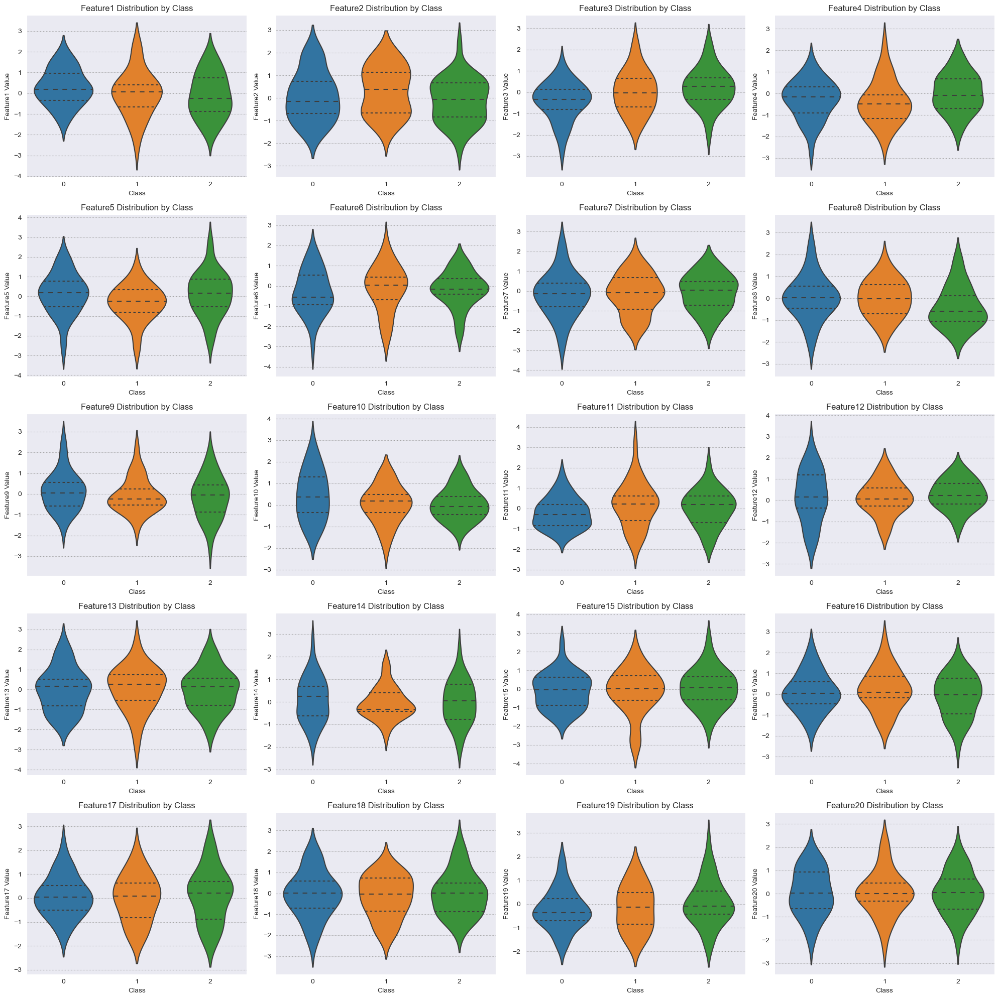

In [79]:
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
np.random.seed(0)

# Create a DataFrame with 20 features and a class column
data = pd.DataFrame({
    f'Feature{i+1}': np.random.normal(loc=0, scale=1, size=100) for i in range(20)
})
data['Class'] = np.random.choice([0, 1, 2], size=100)

# Select the features
selected_features = data.columns[:-1]  # All except the 'Class' column

# Plot violin plots for the selected features
plt.figure(figsize=(20, 20))
for i, feature in enumerate(selected_features, 1):
    plt.subplot(5, 4, i)
    sns.violinplot(x='Class', y=feature, data=data, inner='quartile')
    plt.title(f'{feature} Distribution by Class')
    plt.xlabel('Class')
    plt.ylabel(f'{feature} Value')

plt.tight_layout()
plt.show()


### 3) Özellik Mühendisliği (Feature Engineering)

#### Aykırı Gözlem Analizi

In [12]:
# aykırı gözlem analizi fonksiyonu
def outlier_thresholds(dataframe, col_name, q1=0.25, q3=0.75):
    quartile1 = dataframe[col_name].quantile(q1)
    quartile3 = dataframe[col_name].quantile(q3)
    interquantile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquantile_range
    low_limit = quartile1 - 1.5 * interquantile_range
    return low_limit, up_limit

for col in X:
    outlier_thresholds(X,col)


In [50]:
# her bir özellikte aykırı değer olup olmadığının kontrol edilmesi
def check_outlier(dataframe, col_name):
    low_limit, up_limit = outlier_thresholds(dataframe, col_name)
    if dataframe[(dataframe[col_name] > up_limit) | (dataframe[col_name] < low_limit)].any(axis=None):
        return True
    else:
        return False

for col in X:
    print(col,check_outlier(X,col))

Attribute1 True
Attribute2 True
Attribute3 True
Attribute4 True
Attribute5 True
Attribute6 True
Attribute7 False
Attribute8 True
Attribute9 True
Attribute10 True
Attribute11 True
Attribute12 True
Attribute13 True
Attribute14 True
Attribute15 False
Attribute16 True
Attribute17 True
Attribute18 True
Attribute19 True
Attribute20 True
Attribute21 True


In [51]:
#aykırı değerlerin gözlemlenmesi

def grab_outliers(dataframe, col_name, index=False):
    low, up = outlier_thresholds(dataframe, col_name)

    if dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))].shape[0] > 10:
        print(dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))].head())
    else:
        print(dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))])

    if index:
        outlier_index = dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up))].index
        return outlier_index

for col in X:
    print(col,grab_outliers(X,col))

     Attribute1  Attribute2  Attribute3  Attribute4  Attribute5  Attribute6  \
43        -2.80        1.05        0.18        2.46        1.19        3.40   
275        3.31        0.29        1.60       -1.46       -1.16        1.06   
354       -2.84        0.75        1.21        2.19        3.53        4.65   
387       -2.95        0.22       -1.43        1.88        1.35        5.11   
437        2.85       -1.73        1.03        1.57       -0.30        1.99   

     Attribute7  Attribute8  Attribute9  Attribute10  ...  Attribute12  \
43         4.22        3.53        4.36         4.60  ...         3.56   
275       -0.98       -0.87        3.22         3.17  ...         2.53   
354        5.70        6.23        4.89         2.07  ...         0.49   
387        3.13        5.36        4.13         4.41  ...         2.77   
437        2.04       -0.15        0.93         2.85  ...         4.61   

     Attribute13  Attribute14  Attribute15  Attribute16  Attribute17  \
43      

In [52]:
import warnings
warnings.filterwarnings('ignore')

#aykırı değerlerin değiştirilmesi
def replace_with_thresholds(dataframe, variable):
    low_limit, up_limit = outlier_thresholds(dataframe, variable)
    dataframe.loc[(dataframe[variable] < low_limit), variable] = low_limit
    dataframe.loc[(dataframe[variable] > up_limit), variable] = up_limit

for col in X:
    replace_with_thresholds(X,col)
for col in X:
    print(col, check_outlier(X, col))

Attribute1 False
Attribute2 False
Attribute3 False
Attribute4 False
Attribute5 False
Attribute6 False
Attribute7 False
Attribute8 False
Attribute9 False
Attribute10 False
Attribute11 False
Attribute12 False
Attribute13 False
Attribute14 False
Attribute15 False
Attribute16 False
Attribute17 False
Attribute18 False
Attribute19 False
Attribute20 False
Attribute21 False


#### Eksik Gözlem Analizi

Eksik değer olmadığı için yapılmadı.

In [86]:
#Korelasyon analizi

X.corr()

,Attribute1,Attribute2,Attribute3,Attribute4,Attribute5,Attribute6,Attribute7,Attribute8,Attribute9,Attribute10,...,Attribute12,Attribute13,Attribute14,Attribute15,Attribute16,Attribute17,Attribute18,Attribute19,Attribute20,Attribute21
Attribute1,1.000000,0.003423,-0.012169,-0.008680,-0.010165,0.004137,-0.009013,-0.003839,0.014634,0.024854,...,0.007542,0.007766,0.001805,-0.003470,-0.015913,0.006276,-0.002277,0.012438,-0.002508,-0.020386
Attribute2,0.003423,1.000000,0.168775,0.213461,0.260270,0.271441,0.258351,0.212595,0.134747,-0.005256,...,-0.208421,-0.258262,-0.231897,-0.201180,-0.171940,-0.120851,-0.092422,-0.083039,-0.054279,-0.000344
Attribute3,-0.012169,0.168775,1.000000,0.374465,0.431272,0.440881,0.441140,0.356584,0.210205,-0.003546,...,-0.358036,-0.420786,-0.409608,-0.356806,-0.289925,-0.219864,-0.195160,-0.138999,-0.085499,-0.008018
Attribute4,-0.008680,0.213461,0.374465,1.000000,0.558273,0.570238,0.565654,0.431016,0.260879,-0.004759,...,-0.456945,-0.554744,-0.516987,-0.458736,-0.371134,-0.271460,-0.245468,-0.173345,-0.110105,-0.017804
Attribute5,-0.010165,0.260270,0.431272,0.558273,1.000000,0.655758,0.655959,0.529856,0.301244,0.002767,...,-0.527168,-0.645478,-0.608085,-0.527734,-0.439707,-0.320330,-0.279504,-0.216047,-0.127865,-0.016376
Attribute6,0.004137,0.271441,0.440881,0.570238,0.655758,1.000000,0.715152,0.609172,0.426423,0.134911,...,-0.485247,-0.650616,-0.657202,-0.626638,-0.541052,-0.434415,-0.391283,-0.292207,-0.181628,-0.007026
Attribute7,-0.009013,0.258351,0.441140,0.565654,0.655959,0.715152,1.000000,0.681654,0.521017,0.222603,...,-0.419734,-0.650915,-0.708443,-0.703506,-0.617991,-0.526748,-0.460611,-0.358925,-0.218084,-0.008427
Attribute8,-0.003839,0.212595,0.356584,0.431016,0.529856,0.609172,0.681654,1.000000,0.597733,0.379725,...,-0.241604,-0.526000,-0.647808,-0.709141,-0.668335,-0.604388,-0.526801,-0.410910,-0.244545,-0.017310
Attribute9,0.014634,0.134747,0.210205,0.260879,0.301244,0.426423,0.521017,0.597733,1.000000,0.530862,...,0.013133,-0.309484,-0.507993,-0.653540,-0.654712,-0.641721,-0.561809,-0.429406,-0.265893,0.004549
Attribute10,0.024854,-0.005256,-0.003546,-0.004759,0.002767,0.134911,0.222603,0.379725,0.530862,1.000000,...,0.279733,-0.001376,-0.258707,-0.441606,-0.488087,-0.533741,-0.474314,-0.366670,-0.195897,0.024969


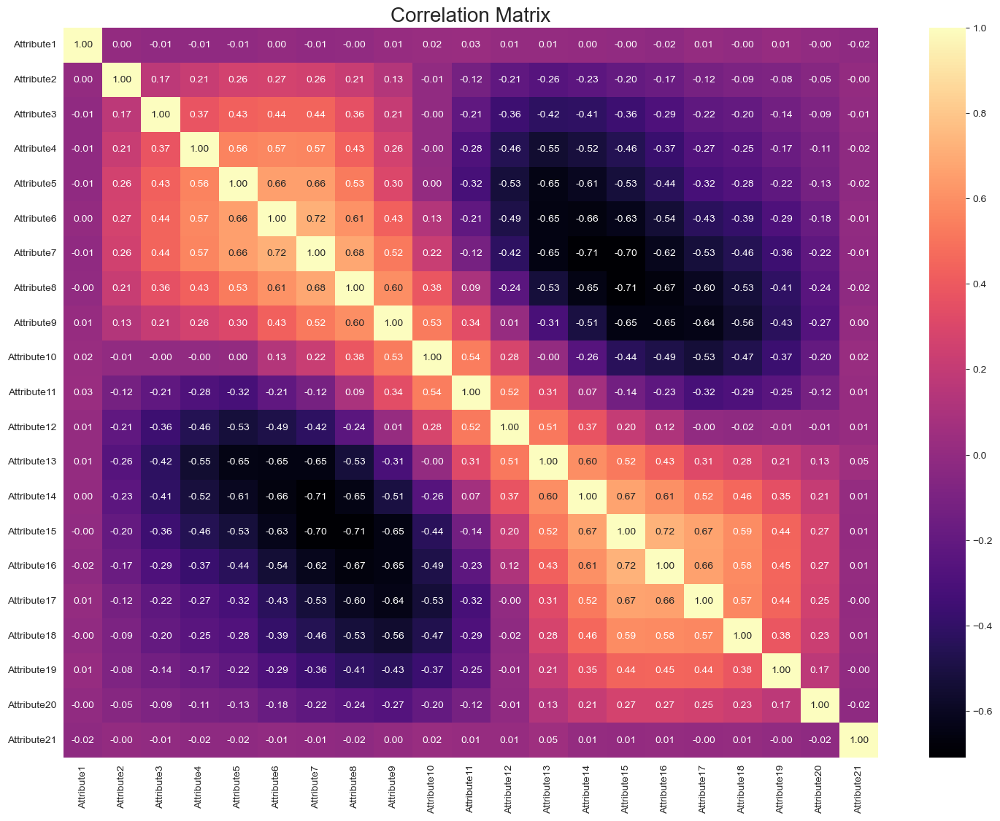

In [87]:
#Korelasyon ilişkisinin heatmap ile gösterilmesi

import matplotlib.pyplot as plt
import seaborn as sns

# Özellikler arasındaki korelasyon ilişkisinin heatmap ile incelenmesi 
# -1 negatif doğrusal ilişki , 1 pozitif doğrusal ilişki, 0 doğrusal ilişki yok

f, ax = plt.subplots(figsize=[18, 13])
sns.heatmap(X.corr(), annot=True, fmt=".2f", ax=ax, cmap="magma")
ax.set_title("Correlation Matrix", fontsize=20)
plt.show()

### 4) Veri Setinin Train ve Test Olarak Ayrılması

In [56]:
n_samples = X.shape[0]
n_train = int(0.8 * n_samples)  # %80 eğitim, %20 test
n_test = n_samples - n_train

X_train, X_test = X[:n_train], X[n_train:]
y_train, y_test = y[:n_train], y[n_train:]


In [89]:
X_train.tail()  #4000 train örneği

,Attribute1,Attribute2,Attribute3,Attribute4,Attribute5,Attribute6,Attribute7,Attribute8,Attribute9,Attribute10,...,Attribute12,Attribute13,Attribute14,Attribute15,Attribute16,Attribute17,Attribute18,Attribute19,Attribute20,Attribute21
3995,-0.48,1.03,0.91,1.40,4.80,3.06,4.80,3.54,2.44,2.57,...,2.75,2.43,2.63,0.18,1.04,0.75,0.58,-0.61,0.16,-1.44
3996,1.01,1.44,0.33,1.88,3.22,2.73,5.70,2.77,2.47,3.01,...,1.02,-0.20,2.87,3.86,2.34,2.23,2.51,0.14,0.72,-0.60
3997,0.43,-0.49,1.14,1.40,2.77,2.76,2.54,3.47,3.17,3.96,...,2.58,2.90,2.82,0.49,-1.37,1.44,1.08,-0.21,0.94,0.12
3998,0.77,1.74,1.37,3.30,2.83,5.65,6.22,5.05,2.05,2.08,...,1.22,-0.02,1.06,0.66,0.04,-0.74,-0.81,-0.39,-1.24,-1.06
3999,-1.18,1.72,0.21,-1.54,1.11,-0.61,0.29,3.15,3.26,4.27,...,5.65,1.68,1.52,2.60,1.24,-1.30,1.09,-0.91,-2.04,1.07


In [90]:
X_test.tail() #1000 test örneği

,Attribute1,Attribute2,Attribute3,Attribute4,Attribute5,Attribute6,Attribute7,Attribute8,Attribute9,Attribute10,...,Attribute12,Attribute13,Attribute14,Attribute15,Attribute16,Attribute17,Attribute18,Attribute19,Attribute20,Attribute21
4995,-0.65,0.69,2.29,-0.16,0.51,0.26,2.34,-0.42,0.49,0.31,...,4.54,3.46,4.81,5.49,5.19,3.10,3.86,2.96,1.09,-1.42
4996,-0.02,0.67,2.34,3.18,2.16,4.77,6.70,4.54,4.92,3.39,...,1.50,1.53,2.52,1.14,-1.56,-1.18,-0.56,0.02,-1.05,-0.18
4997,0.01,-1.99,0.16,2.30,-0.53,1.93,3.61,3.00,4.61,5.73,...,4.25,3.14,3.04,1.61,0.60,-0.52,0.62,1.00,1.21,-0.27
4998,-0.40,0.41,-0.48,1.04,0.79,-0.66,1.18,0.52,2.20,0.59,...,4.85,3.64,3.62,5.97,2.63,3.83,1.72,2.08,1.31,1.37
4999,0.63,-0.07,2.71,2.55,3.36,3.22,3.69,4.67,3.45,3.87,...,1.46,-0.52,1.90,0.88,3.15,1.27,-0.53,0.09,0.01,0.60


### 5) Sınıflandırma Algoritmaları Seçilmesi ve Modelin Eğitilmesi

####  KNN / K-Nearest Neighbors Algoritması (K-En Yakın Komşu Algoritması)

In [57]:
# Özelliklerin ortalamasını 0 ve standart sapmasını 1 yapar. 
# Standardizasyon, her bir özelliği kendi ortalaması (mean) ve standart sapmasına (std) göre ölçeklendirir

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [58]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score

# KNN algoritması için en uygun komşu sayısını bulmak amacıyla çapraz doğrulama kullanır.

k_values = list(range(1, 51))
cv_scores = []
for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_scaled, y_train, cv=5, scoring='accuracy')
    cv_scores.append(scores.mean())
    
print("Çapraz doğrulama skorları:", cv_scores)


Çapraz doğrulama skorları: [0.76425, 0.74825, 0.7917500000000001, 0.7887500000000001, 0.81075, 0.81325, 0.8175000000000001, 0.8227499999999999, 0.827, 0.82825, 0.8262499999999999, 0.8335000000000001, 0.8345, 0.83625, 0.8365, 0.8365, 0.8397500000000001, 0.8390000000000001, 0.8407499999999999, 0.84375, 0.8425, 0.8440000000000001, 0.8452500000000001, 0.843, 0.84375, 0.8460000000000001, 0.84475, 0.8459999999999999, 0.8465, 0.8480000000000001, 0.8462500000000001, 0.8477499999999999, 0.844, 0.8474999999999999, 0.8467499999999999, 0.84825, 0.8472500000000001, 0.8494999999999999, 0.8470000000000001, 0.85025, 0.84975, 0.8517500000000002, 0.8504999999999999, 0.8532500000000001, 0.8530000000000001, 0.8547499999999999, 0.8542500000000001, 0.8547499999999999, 0.8535, 0.8537500000000001]


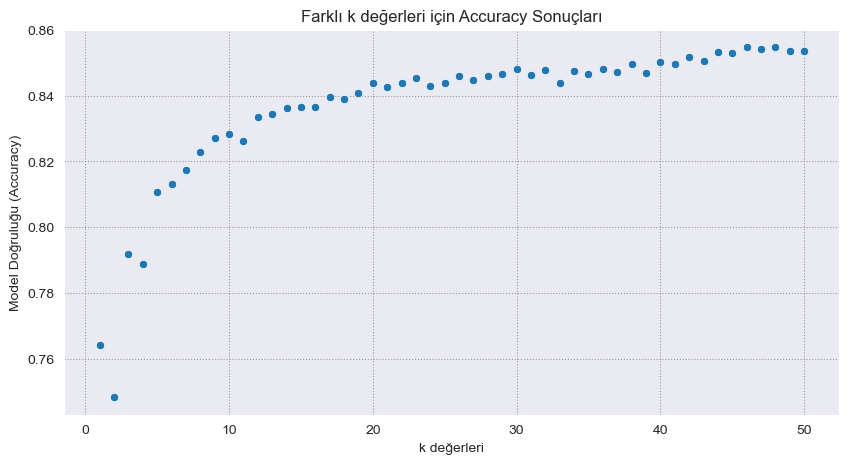

In [93]:
plt.figure(figsize=(10,5))
sns.set_style("darkgrid", {"grid.color": ".6", "grid.linestyle": ":"})
sns.scatterplot(x=k_values, y=cv_scores)
plt.xlabel('k değerleri')
plt.ylabel('Model Doğruluğu (Accuracy)')
plt.title('Farklı k değerleri için Accuracy Sonuçları')
plt.show()


In [59]:
# en iyi doğruluk sonucunu veren k değerini bulma

import numpy as np

best_k = k_values[cv_scores.index(max(cv_scores))]

print(f'The best k value is {best_k}')
best_index = np.argmax(scores)

The best k value is 46


In [60]:
X_train_scaled = np.array(X_train_scaled)
X_test_scaled = np.array(X_test_scaled)

In [61]:
# KNN modelinin train veri seti ile eğitilmesi

knn = KNeighborsClassifier(n_neighbors=best_k)
knn.fit(X_train_scaled, y_train)

KNeighborsClassifier(n_neighbors=46)

In [62]:
# Eğitilmiş KNN modelinin test edilmesi ve doğruluğu

test_accuracy = knn.score(X_test_scaled, y_test)
print("Test accuracy:", test_accuracy)

Test accuracy: 0.854


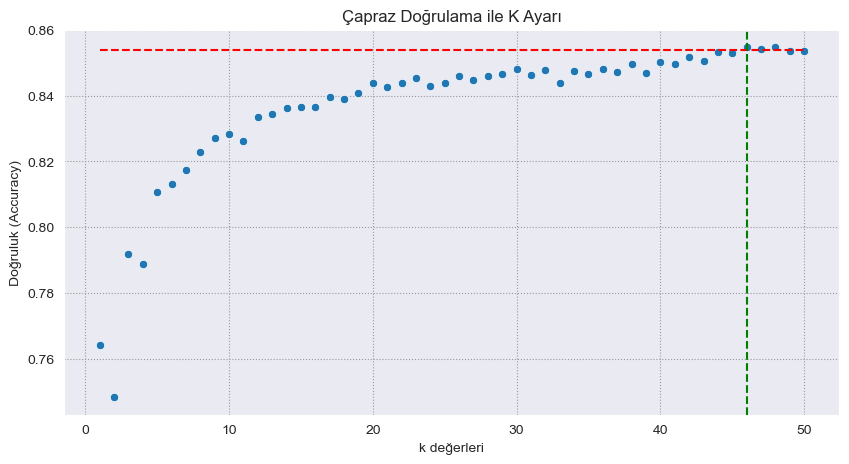

<Figure size 640x480 with 0 Axes>

In [98]:

plt.figure(figsize=(10,5))
sns.set_style("darkgrid", {"grid.color": ".6", "grid.linestyle": ":"})
sns.scatterplot(x=k_values, y=cv_scores)

sns.lineplot(x=k_values,y= [test_accuracy] * len(k_values), linestyle='dashed',color = 'red')

plt.axvline(x=best_k, color='g', linestyle='--')

plt.xlabel('k değerleri')
plt.ylabel('Doğruluk (Accuracy)')
plt.title("Çapraz Doğrulama ile K Ayarı")
plt.show()
plt.savefig('accuracy.png')

In [63]:
# KNN Modelinin Test Doğruluk Sonuçları

y_pred = knn.predict(X_test_scaled)
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
report = classification_report(y_test, y_pred)

print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")
print(f"Test Precision: {precision}")
print(f"Test Recall: {recall}")
print("\nClassification Report:\n", report)

Test Accuracy: 0.854
Test F1 Score: 0.8523568364262646
Test Precision: 0.8564792476489028
Test Recall: 0.854

Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.75      0.81       326
           1       0.86      0.89      0.87       336
           2       0.83      0.92      0.87       338

    accuracy                           0.85      1000
   macro avg       0.86      0.85      0.85      1000
weighted avg       0.86      0.85      0.85      1000



In [101]:
#Sonuçları yazdırma

num_samples = 1000 if len(X_test) > 1000 else len(X_test)
X_test_sample = X_test[:num_samples]
y_test_sample = y_test[:num_samples]
y_pred_sample = y_pred[:num_samples]

# DataFrame oluşturma
results_df = pd.DataFrame(X_test_sample, columns=X.columns)
results_df['y_true'] = y_test_sample
results_df['y_pred'] = y_pred_sample

# Csv dosyasına yazma
results_df.to_csv("knn_predictions.csv", index=False)

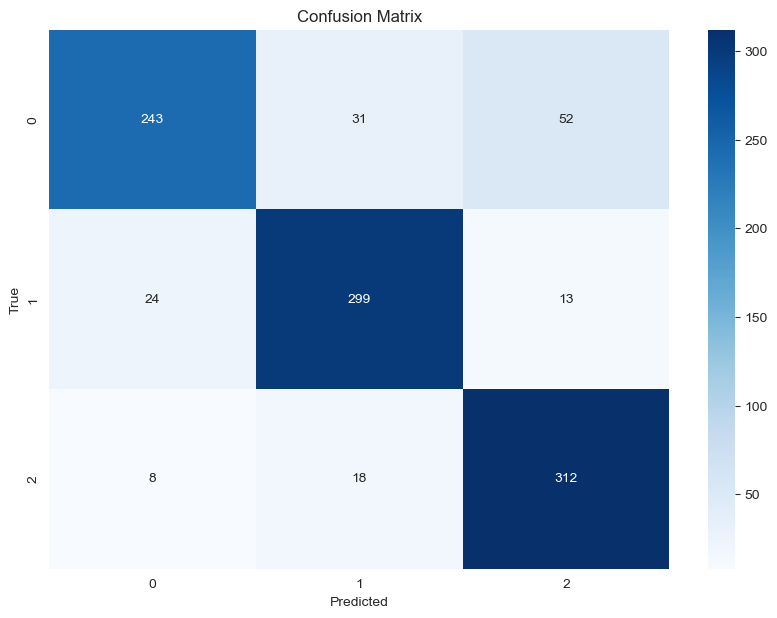

In [102]:
#KNN Modeli Confusion Matrix Oluşturulması

from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test, y_pred)

# Plotting the confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

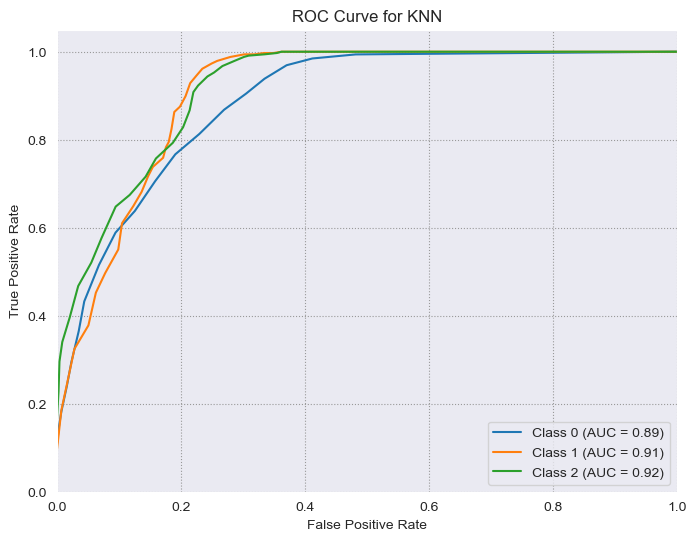

In [103]:
# ROC eğrisinin altındaki alanı ölçerek sınıflandırıcının performansı ölçülür. 
# AUC değerleri genellikle 0 ile 1 arasında değişir.
# Daha yüksek bir AUC değeri daha iyi bir sınıflandırıcı performansını gösterir.

from sklearn.metrics import roc_curve, auc

distances, indices = knn.kneighbors(X_test)
n_classes = len(np.unique(y_train))
y_probabilities = np.zeros((len(y_test), n_classes))
for i, neighbors in enumerate(indices):
    neighbor_classes = y_train.values.ravel()[neighbors] 
    unique_classes, class_counts = np.unique(neighbor_classes, return_counts=True)
    y_probabilities[i, unique_classes] = class_counts / len(neighbors)

fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    true_labels_binary = y_test == i 
    fpr[i], tpr[i], _ = roc_curve(true_labels_binary, y_probabilities[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for KNN')
plt.legend(loc='lower right')
plt.show()

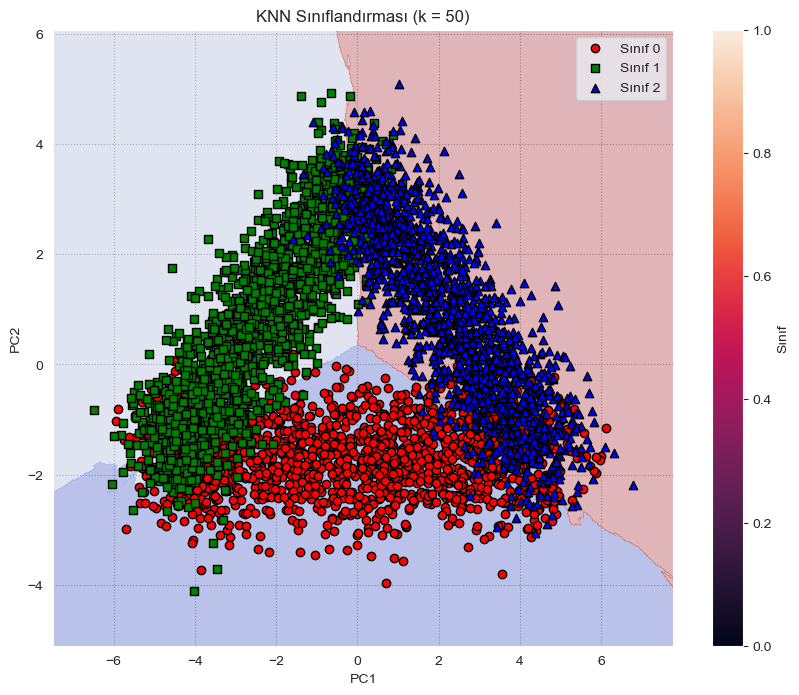

In [104]:
#PCA (Principal component analysis) ile knn modelini 2 boyuta indirgeme ve görselleştirme

from sklearn.decomposition import PCA

# Veri setini çekmek 
waveform_database_generator_version_1 = fetch_ucirepo(id=107)

X = waveform_database_generator_version_1.data.features
y = waveform_database_generator_version_1.data.targets

# y'yi 1D array'e dönüştürme
y = y.values.ravel()

# Veriyi ölçeklendirme
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# PCA ile boyut azaltma (2 bileşen)
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Veri setini eğitim ve test olarak ayırma
n_samples = X_pca.shape[0]
n_train = int(0.8 * n_samples)  # %80 eğitim, %20 test
n_test = n_samples - n_train

X_train_pca, X_test_pca = X_pca[:n_train], X_pca[n_train:]
y_train, y_test = y[:n_train], y[n_train:]

# En iyi k değerini bulmak için çapraz doğrulama ile model eğitimi
k_values = list(range(1, 51))
cv_scores = []
for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_pca, y_train, cv=5, scoring='accuracy')
    cv_scores.append(scores.mean())

best_k = k_values[cv_scores.index(max(cv_scores))]

# KNN modelinin eğitimi
knn = KNeighborsClassifier(n_neighbors=best_k)
knn.fit(X_train_pca, y_train)

# KNN modelinin karar sınırlarını görselleştirme
h = .02  # Mesh gridin adım boyu

x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))

Z = knn.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Sınıflar için marker belirleme
markers = ['o', 's', '^']
colors = ['red', 'green', 'blue']
unique_classes = np.unique(y)

plt.figure(figsize=(10, 8))
plt.contourf(xx, yy, Z, alpha=0.3, cmap='coolwarm')

# Sınıfları ayrı ayrı çizme
for class_value, marker, color in zip(unique_classes, markers, colors):
    plt.scatter(X_pca[y == class_value, 0], X_pca[y == class_value, 1], 
                c=color, label=f'Sınıf {class_value}', marker=marker, edgecolor='k')

plt.title(f"KNN Sınıflandırması (k = {best_k})")
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.colorbar(label='Sınıf')
plt.show()

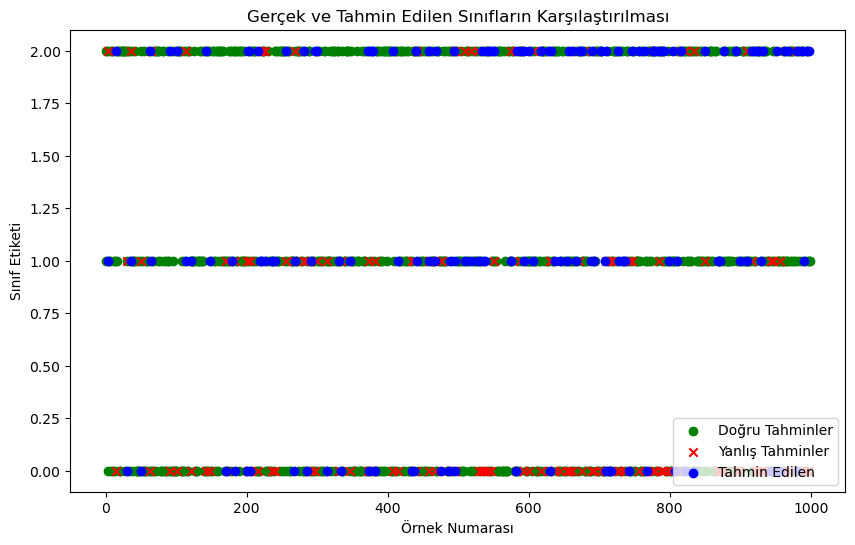

In [64]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Ensure y_test and y_pred_best are numpy arrays
y_test = np.array(y_test)
y_pred_best = np.array(y_pred)

# Convert numpy arrays to pandas Series
y_test_series = pd.Series(y_test.ravel())
y_pred_best_series = pd.Series(y_pred_best.ravel())

# Create DataFrame with pandas Series
predictions_df = pd.DataFrame({'Gerçek': y_test_series, 'Tahmin Edilen': y_pred_best_series})

# Doğru tahmin edilen ve yanlış tahmin edilenleri ayırma
correct_predictions = predictions_df[predictions_df['Gerçek'] == predictions_df['Tahmin Edilen']]
incorrect_predictions = predictions_df[predictions_df['Gerçek'] != predictions_df['Tahmin Edilen']]

# Scatter plot çizme
plt.figure(figsize=(10, 6))

# Doğru tahmin edilenleri çizme
plt.scatter(correct_predictions.index, correct_predictions['Gerçek'], color='green', label='Doğru Tahminler')

# Yanlış tahmin edilenleri çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Gerçek'], color='red', marker='x', label='Yanlış Tahminler')

# Tahmin edilen sınıfları çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Tahmin Edilen'], color='blue', marker='o', label='Tahmin Edilen')

plt.xlabel('Örnek Numarası')
plt.ylabel('Sınıf Etiketi')
plt.title('Gerçek ve Tahmin Edilen Sınıfların Karşılaştırılması')
plt.legend()
plt.show()


#### Naive Bayes Classifier Algoritması

In [31]:
test_accuracies_nb = []

In [32]:
#Naive Bayes modelinin oluşturulması

from sklearn.naive_bayes import GaussianNB

for k in k_values:
    gnb = GaussianNB()
    gnb.fit(X_train, y_train)
    y_pred = gnb.predict(X_test)
    test_accuracies_nb.append((y_pred == np.array(y_test)).mean())

In [33]:
# Naive Bayes modelinin test edilmesi

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

gnb = GaussianNB()
gnb.fit(X_train, y_train)

y_pred = gnb.predict(X_test)
accuracy = (y_pred ==np.array(y_test)).mean()

print(f'Test accuracy: {accuracy:.3f}')

Test accuracy: 0.334


In [34]:
#Dengesizlik kontrolünde sınıf ağırlıkları ile çalışarak Naive Bayes modelini oluşturmak

y_train_flat = np.ravel(y_train)
class_counts = np.bincount(y_train_flat)
class_weights = {i: max(class_counts) / count for i, count in enumerate(class_counts)}
sum_weights = sum(class_weights.values())
class_priors = {i: weight / sum_weights for i, weight in class_weights.items()}

gnb_balanced = GaussianNB(priors=list(class_priors.values()))
gnb_balanced.fit(X_train, y_train_flat)
y_pred_balanced = gnb_balanced.predict(X_test)
accuracy_balanced = np.mean(y_pred_balanced == np.array(y_test))
print(f'Sınıf ağırlıkları ile test accuracy : {accuracy_balanced:.3f}')
cv_scores_balanced = cross_val_score(gnb_balanced, X, y, cv=5)
print(f'Sınıf ağırlıklakları ile cross validation: {cv_scores_balanced}')
print(f'Sınıf ağırlıkları ile ortalama CV accuracy: {np.mean(cv_scores_balanced):.3f}')

Sınıf ağırlıkları ile test accuracy : 0.334
Sınıf ağırlıklakları ile cross validation: [0.817 0.796 0.806 0.814 0.819]
Sınıf ağırlıkları ile ortalama CV accuracy: 0.810


In [35]:
#GridSearchCV ile hiperparametre optimizasyonu değerlendirilmesi

from sklearn.model_selection import GridSearchCV

# Hiperparametre aralığı
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6],  # Örnek var_smoothing değerleri
    'priors': [None, [0.3, 0.3, 0.4], [0.25, 0.25, 0.5]]  # Örnek priors değerleri
}

# GridSearchCV ile 5 katlı çapraz doğrulama kullanarak hiperparametre optimizasyonu 
grid_search = GridSearchCV(estimator=gnb, param_grid=param_grid, cv=7)
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
print("En İyi Hiperparametreler:", best_params)

# Optimizasyon yapılmış model ile test verileri üzerinde doğruluk
gnb_optimized = grid_search.best_estimator_
accuracy = gnb_optimized.score(X_test, y_test)
print("Optimizasyon Yapılmış Hiperparametreler ile Test Doğruluğu:", accuracy)

En İyi Hiperparametreler: {'priors': None, 'var_smoothing': 1e-09}
Optimizasyon Yapılmış Hiperparametreler ile Test Doğruluğu: 0.802


In [36]:
# Naive Bayes modelinin test doğruluk sonuçları

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
report = classification_report(y_test, y_pred)

print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")
print(f"Test Precision: {precision}")
print(f"Test Recall: {recall}")
print("\nClassification Report:\n", report)

Test Accuracy: 0.802
Test F1 Score: 0.7900948122605582
Test Precision: 0.8348908640091549
Test Recall: 0.802

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.53      0.69       333
           1       0.77      0.93      0.84       354
           2       0.76      0.95      0.84       313

    accuracy                           0.80      1000
   macro avg       0.83      0.80      0.79      1000
weighted avg       0.83      0.80      0.79      1000



In [37]:
#Sonuçları yazdırma

num_samples = 1000 if len(X_test) > 1000 else len(X_test)
X_test_sample = X_test[:num_samples]
y_test_sample = y_test[:num_samples]
y_pred_sample = y_pred[:num_samples]

# DataFrame oluşturma
results_df = pd.DataFrame(X_test_sample, columns=X.columns)
results_df['y_true'] = y_test_sample
results_df['y_pred'] = y_pred_sample

# Csv dosyasına yazma
results_df.to_csv("naivebayes_predictions.csv", index=False)

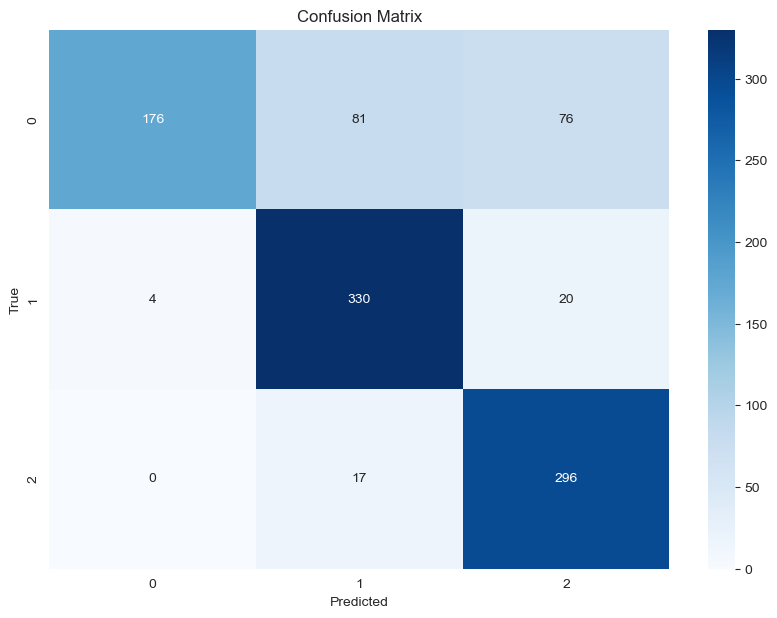

In [141]:
#Naive Bayes modeli için confusion matrix oluşturulması

conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

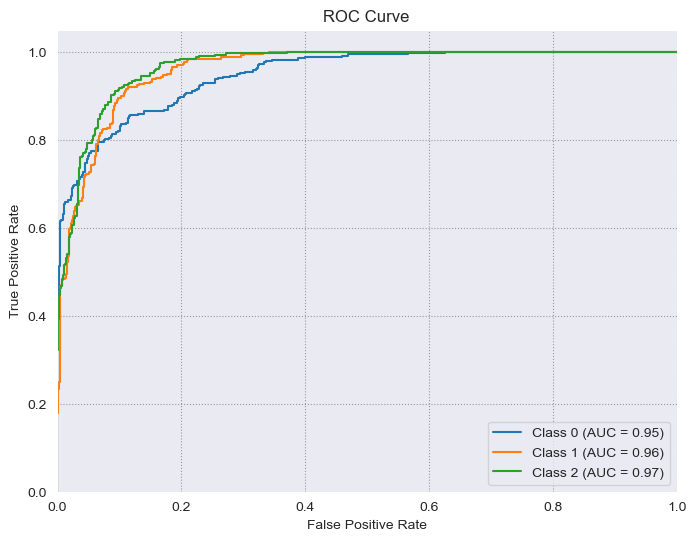

In [142]:
# ROC eğrisinin altındaki alanı ölçerek sınıflandırıcının performansı ölçülür. 
# AUC değerleri genellikle 0 ile 1 arasında değişir.
# Daha yüksek bir AUC değeri daha iyi bir sınıflandırıcı performansını gösterir.

from sklearn.metrics import roc_curve, auc
y_probabilities = gnb_optimized.predict_proba(X_test)

n_classes = y_probabilities.shape[1]
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_probabilities[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

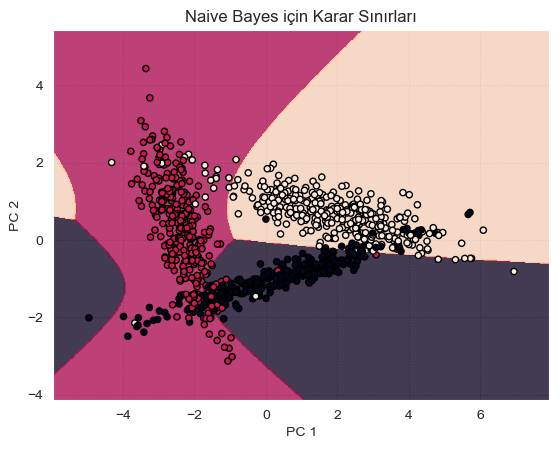

In [143]:
#PCA (Principal component analysis) ile knn modelini 2 boyuta indirgeme ve görselleştirme
from sklearn.datasets import make_classification

X, y = make_classification(n_samples=1000, n_features=4, n_classes=3, n_clusters_per_class=1, random_state=42)

# Veri setini iki boyuta indirgeme
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Modeli eğitme
gnb = GaussianNB()
gnb.fit(X_pca, y)

# Karar sınırlarını çizme
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02), np.arange(y_min, y_max, 0.02))
Z = gnb.predict(np.c_[xx.ravel(), yy.ravel()])

# Sonuçları görselleştirme
Z = Z.reshape(xx.shape)
plt.contourf(xx, yy, Z, alpha=0.8)

plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, s=20, edgecolor='k')
plt.xlabel('PC 1')
plt.ylabel('PC 2')
plt.title('Naive Bayes için Karar Sınırları')
plt.show()


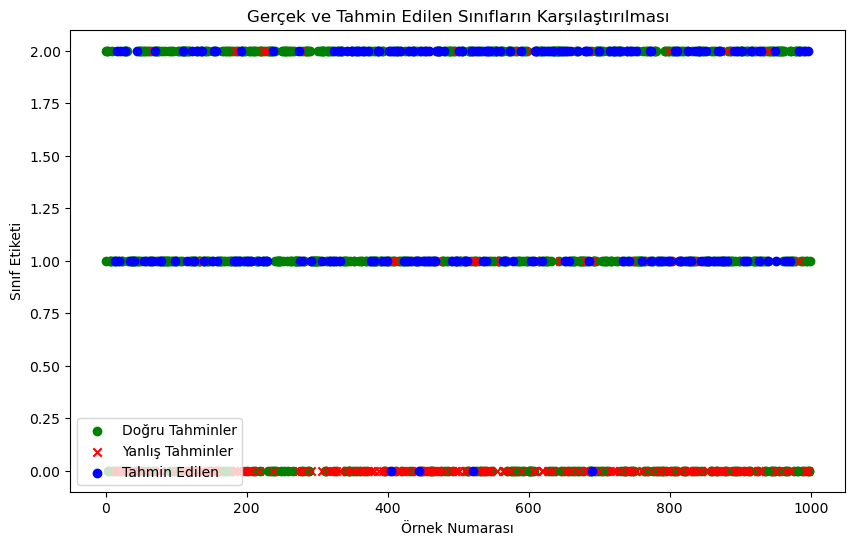

In [43]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Ensure y_test and y_pred_best are numpy arrays
y_test = np.array(y_test_sample)
y_pred_best = np.array(y_pred_sample)

# Convert numpy arrays to pandas Series
y_test_series = pd.Series(y_test.ravel())
y_pred_best_series = pd.Series(y_pred_best.ravel())

# Create DataFrame with pandas Series
predictions_df = pd.DataFrame({'Gerçek': y_test_series, 'Tahmin Edilen': y_pred_best_series})

# Doğru tahmin edilen ve yanlış tahmin edilenleri ayırma
correct_predictions = predictions_df[predictions_df['Gerçek'] == predictions_df['Tahmin Edilen']]
incorrect_predictions = predictions_df[predictions_df['Gerçek'] != predictions_df['Tahmin Edilen']]

# Scatter plot çizme
plt.figure(figsize=(10, 6))

# Doğru tahmin edilenleri çizme
plt.scatter(correct_predictions.index, correct_predictions['Gerçek'], color='green', label='Doğru Tahminler')

# Yanlış tahmin edilenleri çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Gerçek'], color='red', marker='x', label='Yanlış Tahminler')

# Tahmin edilen sınıfları çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Tahmin Edilen'], color='blue', marker='o', label='Tahmin Edilen')

plt.xlabel('Örnek Numarası')
plt.ylabel('Sınıf Etiketi')
plt.title('Gerçek ve Tahmin Edilen Sınıfların Karşılaştırılması')
plt.legend()
plt.show()


#### C4.5 Karar Ağacı Algoritması

In [179]:

class C45Node:
    def __init__(self, feature=None, threshold=None, value=None, left=None, right=None):
        self.feature = feature      # Bölme özelliği
        self.threshold = threshold  # Bölme eşiği (sadece sayısal özellikler için)
        self.value = value          # Düğüm değeri (sınıf etiketi)
        self.left = left            # Sol alt ağaç
        self.right = right          # Sağ alt ağaç

class C45DecisionTree:
    def __init__(self, max_depth=None):
        self.max_depth = max_depth  # Ağaç derinliği sınırlayıcı
        self.root = None            # Kök düğüm

    def _calculate_entropy(self, y):
        # Entropi hesaplama
        classes, counts = np.unique(y, return_counts=True)
        probabilities = counts / len(y)
        entropy = -np.sum(probabilities * np.log2(probabilities))
        return entropy

    def _calculate_information_gain(self, X, y, feature, threshold):
        # Bilgi kazancı hesaplama
        left_indices = X[:, feature] <= threshold
        right_indices = ~left_indices
        left_entropy = self._calculate_entropy(y[left_indices])
        right_entropy = self._calculate_entropy(y[right_indices])
        parent_entropy = self._calculate_entropy(y)
        left_weight = np.sum(left_indices) / len(y)
        right_weight = 1 - left_weight
        information_gain = parent_entropy - (left_weight * left_entropy + right_weight * right_entropy)
        return information_gain

    def _find_best_split(self, X, y):
        # En iyi bölünmeyi bulma
        best_feature = None
        best_threshold = None
        best_information_gain = -np.inf
        for feature in range(X.shape[1]):
            unique_values = np.unique(X[:, feature])
            for threshold in unique_values:
                information_gain = self._calculate_information_gain(X, y, feature, threshold)
                if information_gain > best_information_gain:
                    best_information_gain = information_gain
                    best_feature = feature
                    best_threshold = threshold
        return best_feature, best_threshold

    def _build_tree(self, X, y, depth):
        # Ağaç oluşturma (rekürsif)
        if depth == 0 or len(np.unique(y)) == 1:
            # Maksimum derinlik veya saf düğüm
            value = np.bincount(y.astype(int)).argmax()
            return C45Node(value=value)
        best_feature, best_threshold = self._find_best_split(X, y)
        if best_feature is None:
            # En iyi bölünme yok
            value = np.bincount(y.astype(int)).argmax()
            return C45Node(value=value)
        left_indices = X[:, best_feature] <= best_threshold
        right_indices = ~left_indices
        left_tree = self._build_tree(X[left_indices], y[left_indices], depth - 1)
        right_tree = self._build_tree(X[right_indices], y[right_indices], depth - 1)
        return C45Node(feature=best_feature, threshold=best_threshold, left=left_tree, right=right_tree)

    def fit(self, X, y):
        # Ağacı eğitme
        self.root = self._build_tree(X, y, self.max_depth)

    def _predict_single(self, x, node):
        # Tek bir örnek için tahmin yapma
        if node.value is not None:
            return node.value
        if x[node.feature] <= node.threshold:
            return self._predict_single(x, node.left)
        else:
            return self._predict_single(x, node.right)

    def predict(self, X):
        # Birden fazla örnek için tahmin yapma
        if self.root is None:
            raise ValueError("Model eğitilmedi.")
        return np.array([self._predict_single(x, self.root) for x in X])

In [183]:
# C4.5 modelinin eğitilmesi ve test edilmesi

# Eğitim ve test veri setlerini ayırma

# Veri setini eğitim ve test olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Verileri numpy dizilerine dönüştürme
X_train = np.array(X_train)
y_train = np.array(y_train).flatten()
X_test = np.array(X_test)
y_test = np.array(y_test).flatten()

# C4.5 karar ağacı modelini eğitme
c45_model = C45DecisionTree(max_depth=7)
c45_model.fit(X_train, y_train)

# Test veri seti üzerinde modelin performansını değerlendirme
y_pred = c45_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy:", accuracy)


Test Accuracy: 0.783


In [184]:
# C4.5 modelinin test doğruluk sonuçları

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
report = classification_report(y_test, y_pred)

print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")
print(f"Test Precision: {precision}")
print(f"Test Recall: {recall}")
print("\nClassification Report:\n", report)

Test Accuracy: 0.783
Test F1 Score: 0.7819079062343671
Test Precision: 0.7855457976638439
Test Recall: 0.783

Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.70      0.75       333
           1       0.76      0.82      0.79       354
           2       0.77      0.84      0.80       313

    accuracy                           0.78      1000
   macro avg       0.79      0.78      0.78      1000
weighted avg       0.79      0.78      0.78      1000



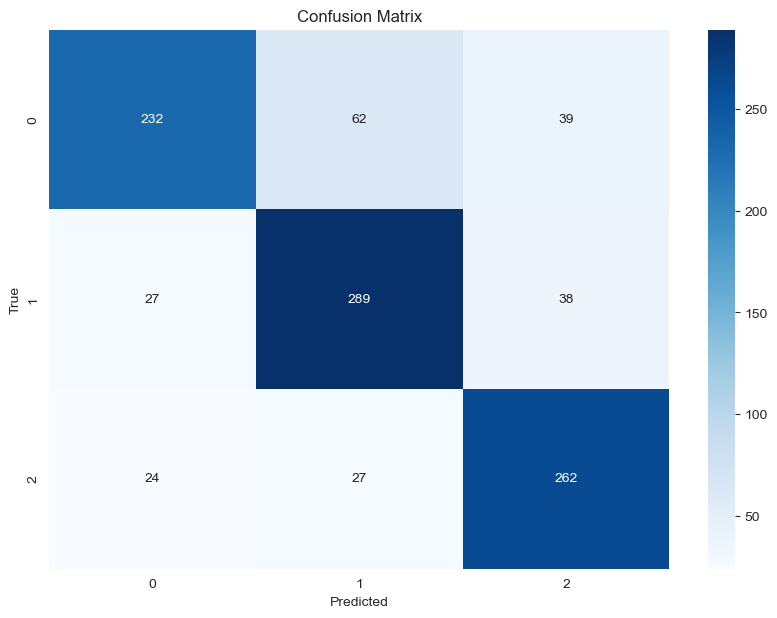

In [185]:
#C4.5 modeli için confusion matrix oluşturulması

conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

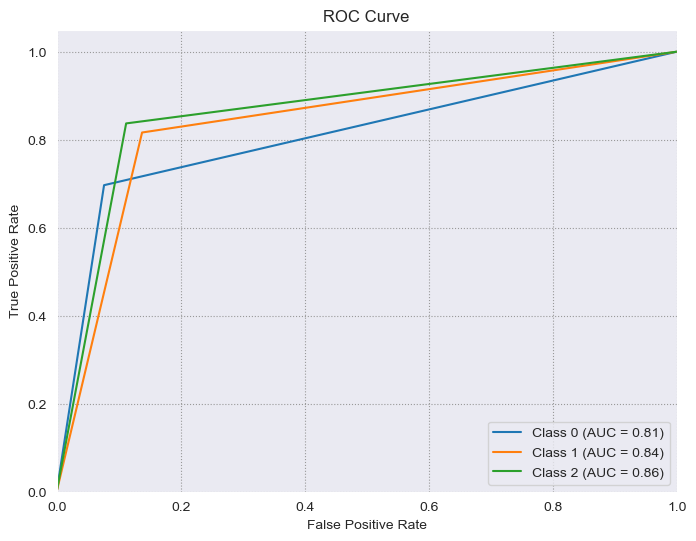

In [186]:
# ROC eğrisinin altındaki alanı ölçerek sınıflandırıcının performansı ölçülür. 
# AUC değerleri genellikle 0 ile 1 arasında değişir.
# Daha yüksek bir AUC değeri daha iyi bir sınıflandırıcı performansını gösterir.

from sklearn.metrics import roc_curve, auc
y_pred = c45_model.predict(X_test)
n_classes = len(np.unique(y_pred))

fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_pred == i)
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

#### CART Karar Ağacı Algoritması

In [192]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 4. Karar Ağacı Modelini Oluşturma
dt_model = DecisionTreeClassifier(criterion='entropy')  # ID3 için entropi kullanılır
dt_model.fit(X_train, y_train)

# 5. Modeli Değerlendirme
y_pred = dt_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Doğruluğu:", accuracy)

Test Doğruluğu: 0.774


In [193]:
# Cross-validation ile doğruluk skorlarını hesaplayın
cv_scores = cross_val_score(dt_model, X_train, y_train, cv=5)

# Ortalama doğruluk skorunu hesaplayın
accuracy = cv_scores.mean()

print("Genel Doğruluk Skoru:", accuracy)

Genel Doğruluk Skoru: 0.74925


In [194]:
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
report = classification_report(y_test, y_pred)

# Displaying the results
print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")
print(f"Test Precision: {precision}")
print(f"Test Recall: {recall}")
print("\nClassification Report:\n", report)

Test Accuracy: 0.774
Test F1 Score: 0.7738986302683141
Test Precision: 0.7740866689671039
Test Recall: 0.774

Classification Report:
               precision    recall  f1-score   support

           0       0.78      0.75      0.76       333
           1       0.78      0.78      0.78       354
           2       0.77      0.80      0.78       313

    accuracy                           0.77      1000
   macro avg       0.77      0.77      0.77      1000
weighted avg       0.77      0.77      0.77      1000



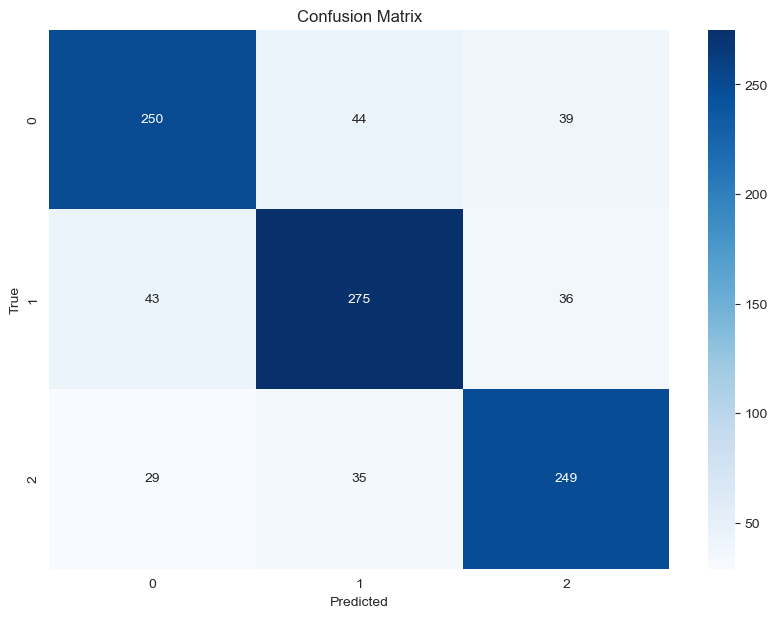

In [195]:
conf_matrix = confusion_matrix(y_test, y_pred)

# Plotting the confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

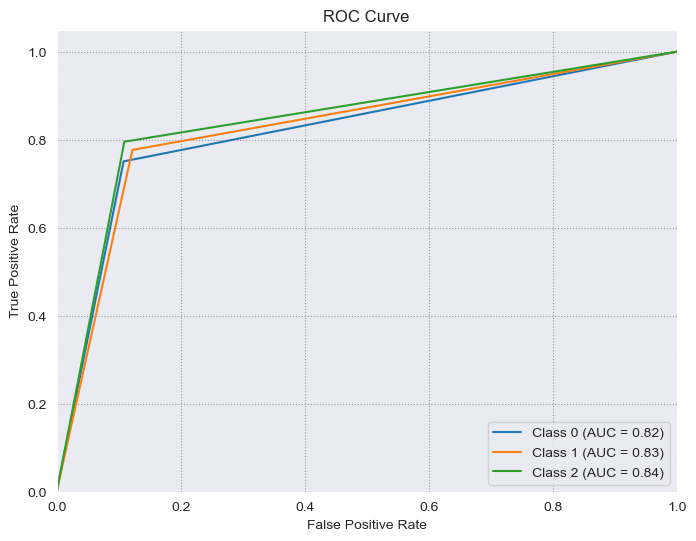

In [196]:
from sklearn.metrics import roc_curve, auc
y_probabilities = dt_model.predict_proba(X_test)

# Determine the number of classes
n_classes = y_probabilities.shape[1]

# Compute ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_probabilities[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

#### XGBoost Sınıflandırma Algoritması

In [197]:
import xgboost as xgb

# Veri setini eğitim ve test olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost modelini oluşturma
model = xgb.XGBClassifier(objective='binary:logistic', max_depth=3, learning_rate=0.1, n_estimators=100)
model.fit(X_train, y_train)

# Modeli değerlendirme
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Doğruluğu:", accuracy)


Test Doğruluğu: 0.851


In [198]:
# Parametre aralığı belirleme
param_grid = {
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [100, 200, 300],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
}

# GridSearchCV ile en iyi parametreleri bulma
grid_search = GridSearchCV(estimator=xgb.XGBClassifier(objective='multi:softmax', num_class=3), param_grid=param_grid, 
                           scoring='accuracy', cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train, y_train)

# En iyi parametreleri yazdırma
print(f'En iyi parametreler: {grid_search.best_params_}')

# En iyi model ile tahmin yapma
best_model = grid_search.best_estimator_
y_pred_best = best_model.predict(X_test)

# En iyi modelin doğruluk oranı
accuracy_best = accuracy_score(y_test, y_pred_best)
print(f'Optimizasyon sonrası test doğruluğu: {accuracy_best:.3f}')



Fitting 5 folds for each of 108 candidates, totalling 540 fits
En iyi parametreler: {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'subsample': 0.8}
Optimizasyon sonrası test doğruluğu: 0.857


              precision    recall  f1-score   support

           0       0.89      0.79      0.84       333
           1       0.85      0.90      0.87       354
           2       0.83      0.88      0.85       313

    accuracy                           0.86      1000
   macro avg       0.86      0.86      0.86      1000
weighted avg       0.86      0.86      0.86      1000



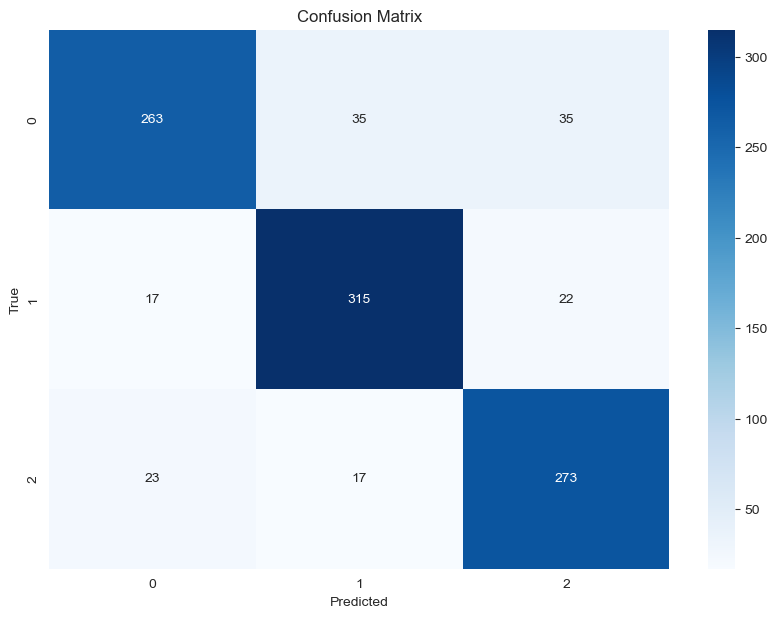

In [199]:
print(classification_report(y_test, y_pred_best))

# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [200]:
#Sonuçları yazdırma

num_samples = 1000 if len(X_test) > 1000 else len(X_test)
X_test_sample = X_test[:num_samples]
y_test_sample = y_test[:num_samples]
y_pred_sample = y_pred_best[:num_samples]

# DataFrame oluşturma - sütun adlarını manuel olarak belirleme
feature_columns = [f'feature_{i}' for i in range(X_test_sample.shape[1])]
results_df = pd.DataFrame(X_test_sample, columns=feature_columns)
results_df['y_true'] = y_test_sample
results_df['y_pred'] = y_pred_sample

# CSV dosyasına yazma
results_df.to_csv("xgboost_predictions.csv", index=False)

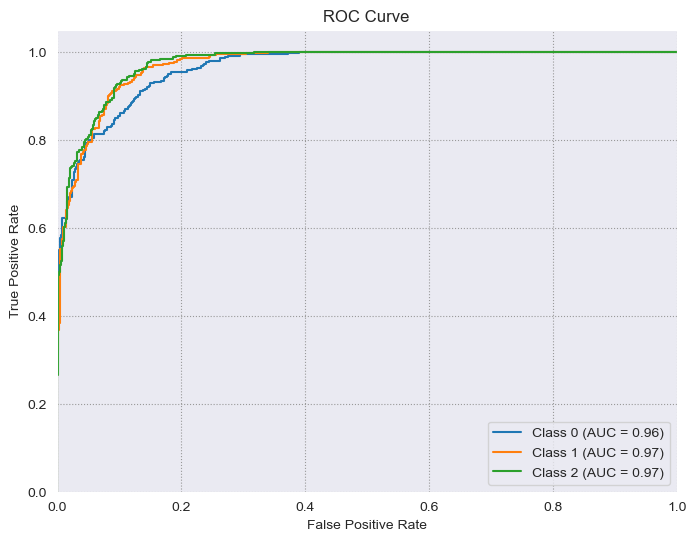

In [201]:
from sklearn.metrics import roc_curve, auc
y_probabilities = best_model.predict_proba(X_test)

n_classes = y_probabilities.shape[1]


fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_probabilities[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])


plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

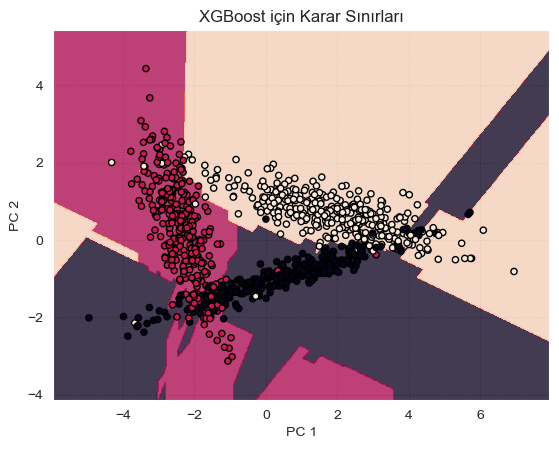

In [202]:
from sklearn.datasets import make_classification
from sklearn.decomposition import PCA
import xgboost as xgb
import matplotlib.pyplot as plt
import numpy as np

X, y = make_classification(n_samples=1000, n_features=4, n_classes=3, n_clusters_per_class=1, random_state=42)

# Veri setini iki boyuta indirgeme
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# XGBoost modelini oluşturma ve eğitme
xg_model = xgb.XGBClassifier(objective='multi:softmax', num_class=3, max_depth=3, learning_rate=0.1, n_estimators=100)
xg_model.fit(X, y)

# Karar sınırlarını çizme
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02), np.arange(y_min, y_max, 0.02))

# İki boyutlu meshgrid verisini dört boyuta genişletme
grid_2d = np.c_[xx.ravel(), yy.ravel()]
grid_4d = pca.inverse_transform(grid_2d)  # Ters dönüşüm

# Tahmin olasılıklarını almak için 4 boyutlu veriyi kullanma
Z_probs = xg_model.predict_proba(grid_4d)

# Sonuçları görselleştirme
Z_probs = Z_probs.reshape(xx.shape + (-1,))
Z_classes = np.argmax(Z_probs, axis=-1)

plt.contourf(xx, yy, Z_classes, alpha=0.8)

plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, s=20, edgecolor='k')
plt.xlabel('PC 1')
plt.ylabel('PC 2')
plt.title('XGBoost için Karar Sınırları')
plt.show()

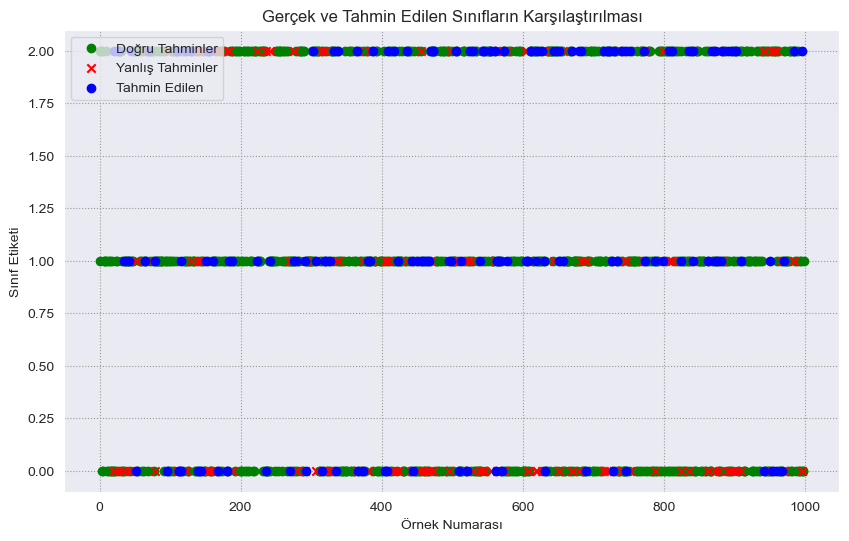

In [203]:
# Tahmin edilen ve gerçek etiketlerin bulunduğu DataFrame oluşturma
predictions_df = pd.DataFrame({'Gerçek': y_test.values.ravel(), 'Tahmin Edilen': y_pred_best.ravel()})

# Doğru tahmin edilen ve yanlış tahmin edilenleri ayırma
correct_predictions = predictions_df[predictions_df['Gerçek'] == predictions_df['Tahmin Edilen']]
incorrect_predictions = predictions_df[predictions_df['Gerçek'] != predictions_df['Tahmin Edilen']]

# Scatter plot çizme
plt.figure(figsize=(10, 6))

# Doğru tahmin edilenleri çizme
plt.scatter(correct_predictions.index, correct_predictions['Gerçek'], color='green', label='Doğru Tahminler')

# Yanlış tahmin edilenleri çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Gerçek'], color='red', marker='x', label='Yanlış Tahminler')

# Tahmin edilen sınıfları çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Tahmin Edilen'], color='blue', marker='o', label='Tahmin Edilen')

plt.xlabel('Örnek Numarası')
plt.ylabel('Sınıf Etiketi')
plt.title('Gerçek ve Tahmin Edilen Sınıfların Karşılaştırılması')
plt.legend()
plt.show()


#### Support Vector Machine Algoritması

In [204]:
from sklearn.svm import SVC

# Eğitim ve test setlerine ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Veriyi ölçeklendirme
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# SVM modelini oluşturma
svm_model = SVC(kernel='linear', probability=True)  
svm_model.fit(X_train, y_train)

SVC(kernel='linear', probability=True)

In [205]:
# Test seti üzerinde tahmin yapma
y_pred = svm_model.predict(X_test)

# Doğruluk oranını hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f'Test Doğruluğu: {accuracy:.3f}')

# Detaylı sınıflandırma raporu
print(classification_report(y_test, y_pred))

Test Doğruluğu: 0.885
              precision    recall  f1-score   support

           0       0.80      0.95      0.87        59
           1       0.91      0.86      0.88        70
           2       0.95      0.86      0.90        71

    accuracy                           0.89       200
   macro avg       0.89      0.89      0.88       200
weighted avg       0.89      0.89      0.89       200



In [206]:
# Parametre aralığı belirleme
param_grid = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'gamma': ['scale', 'auto']
}

# GridSearchCV ile en iyi parametreleri bulma
grid_search = GridSearchCV(SVC(probability=True), param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

# En iyi parametreleri yazdırma
print(f'En iyi parametreler: {grid_search.best_params_}')

# En iyi model ile tahmin yapma
best_model = grid_search.best_estimator_
y_pred_best = best_model.predict(X_test)

# En iyi modelin doğruluk oranı
accuracy_best = accuracy_score(y_test, y_pred_best)
print(f'Optimizasyon sonrası test doğruluğu: {accuracy_best:.3f}')

En iyi parametreler: {'C': 100, 'gamma': 'scale', 'kernel': 'rbf'}
Optimizasyon sonrası test doğruluğu: 0.915


In [209]:
# Detaylı sınıflandırma raporu
accuracy = accuracy_score(y_test, y_pred_best)
f1 = f1_score(y_test, y_pred_best, average='weighted')
precision = precision_score(y_test, y_pred_best, average='weighted')
recall = recall_score(y_test, y_pred_best, average='weighted')
report = classification_report(y_test, y_pred_best)

# Displaying the results
print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")
print(f"Test Precision: {precision}")
print(f"Test Recall: {recall}")
print("\nClassification Report:\n", report)

Test Accuracy: 0.915
Test F1 Score: 0.9157617989288531
Test Precision: 0.919972114972115
Test Recall: 0.915

Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.93      0.90        59
           1       0.88      0.93      0.90        70
           2       1.00      0.89      0.94        71

    accuracy                           0.92       200
   macro avg       0.92      0.92      0.91       200
weighted avg       0.92      0.92      0.92       200



In [210]:
num_samples = 1000 if len(X_test) > 1000 else len(X_test)
X_test_sample = X_test[:num_samples]
y_test_sample = y_test[:num_samples]
y_pred_sample = y_pred_best[:num_samples]

# DataFrame oluşturma - sütun adlarını manuel olarak belirleme
feature_columns = [f'feature_{i}' for i in range(X_test_sample.shape[1])]
results_df = pd.DataFrame(X_test_sample, columns=feature_columns)
results_df['y_true'] = y_test_sample
results_df['y_pred'] = y_pred_sample

# CSV dosyasına yazma
results_df.to_csv("svm_predictions.csv", index=False)

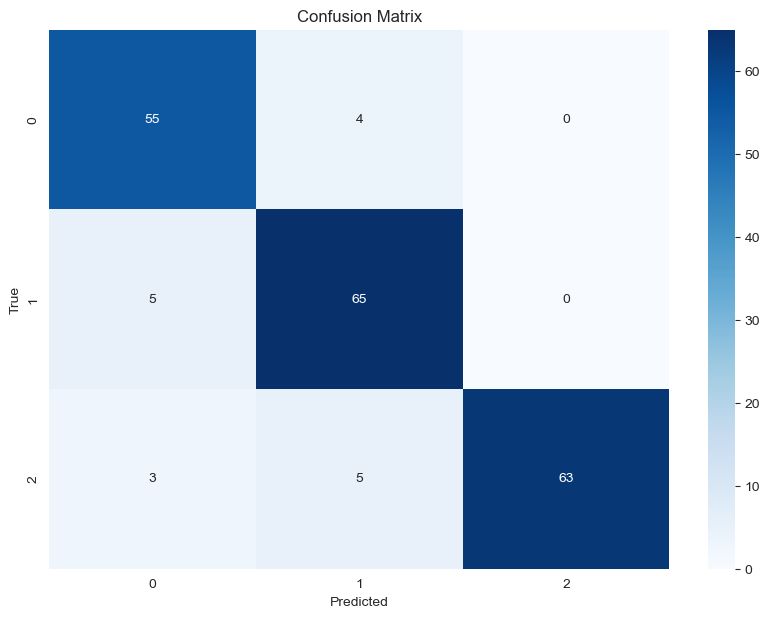

In [211]:
# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred_best)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

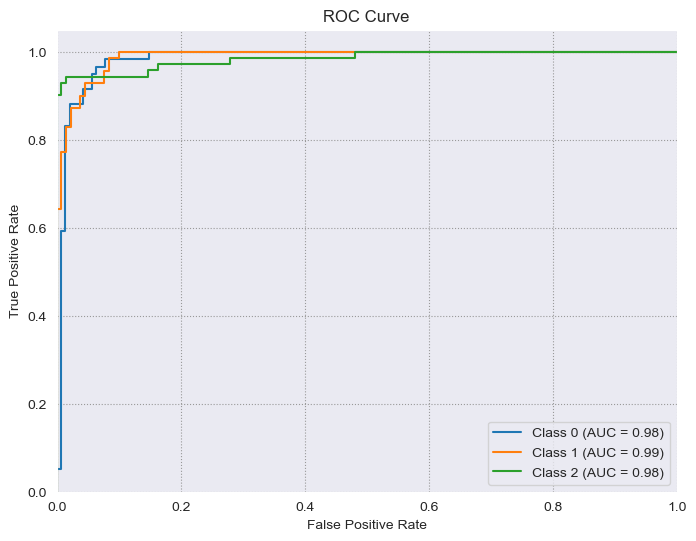

In [212]:
from sklearn.metrics import roc_curve, auc
y_probabilities = best_model.predict_proba(X_test)


n_classes = y_probabilities.shape[1]


fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_probabilities[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])


plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

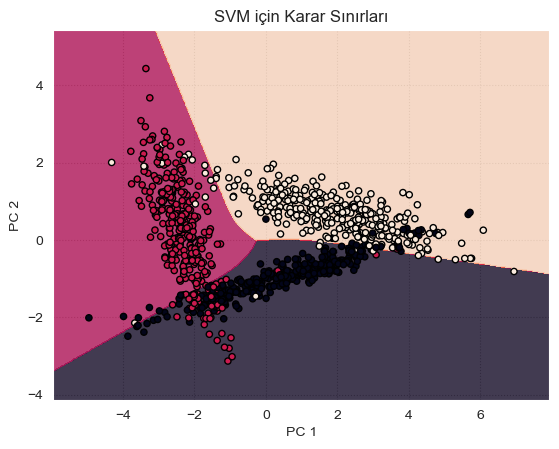

In [213]:
from sklearn.datasets import make_classification
from sklearn.decomposition import PCA
from sklearn.svm import SVC
import matplotlib.pyplot as plt
import numpy as np

# Veri setini oluşturma
X, y = make_classification(n_samples=1000, n_features=4, n_classes=3, n_clusters_per_class=1, random_state=42)

# Veri setini iki boyuta indirgeme
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# SVM modelini oluşturma ve eğitme
svm_model = SVC(kernel='linear', probability=True)
svm_model.fit(X_pca, y)

# Karar sınırlarını çizme
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02), np.arange(y_min, y_max, 0.02))

# Tahmin olasılıklarını almak için meshgrid verisini kullanma
Z_probs = svm_model.predict_proba(np.c_[xx.ravel(), yy.ravel()])

# Sonuçları görselleştirme
Z_probs = Z_probs.reshape(xx.shape + (-1,))
Z_classes = np.argmax(Z_probs, axis=-1)

plt.contourf(xx, yy, Z_classes, alpha=0.8)

plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, s=20, edgecolor='k')
plt.xlabel('PC 1')
plt.ylabel('PC 2')
plt.title('SVM için Karar Sınırları')
plt.show()


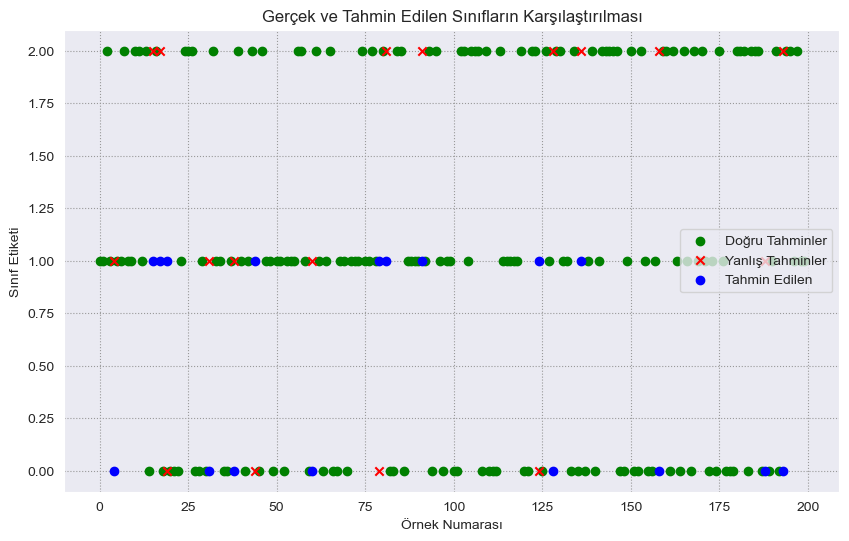

In [216]:
import matplotlib.pyplot as plt
import pandas as pd

# Convert numpy arrays to pandas Series
y_test_series = pd.Series(y_test.ravel())
y_pred_best_series = pd.Series(y_pred_best.ravel())

# Create DataFrame with pandas Series
predictions_df = pd.DataFrame({'Gerçek': y_test_series, 'Tahmin Edilen': y_pred_best_series})

# Doğru tahmin edilen ve yanlış tahmin edilenleri ayırma
correct_predictions = predictions_df[predictions_df['Gerçek'] == predictions_df['Tahmin Edilen']]
incorrect_predictions = predictions_df[predictions_df['Gerçek'] != predictions_df['Tahmin Edilen']]

# Scatter plot çizme
plt.figure(figsize=(10, 6))

# Doğru tahmin edilenleri çizme
plt.scatter(correct_predictions.index, correct_predictions['Gerçek'], color='green', label='Doğru Tahminler')

# Yanlış tahmin edilenleri çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Gerçek'], color='red', marker='x', label='Yanlış Tahminler')

# Tahmin edilen sınıfları çizme
plt.scatter(incorrect_predictions.index, incorrect_predictions['Tahmin Edilen'], color='blue', marker='o', label='Tahmin Edilen')

plt.xlabel('Örnek Numarası')
plt.ylabel('Sınıf Etiketi')
plt.title('Gerçek ve Tahmin Edilen Sınıfların Karşılaştırılması')
plt.legend()
plt.show()


In [11]:
colors = ['yellow', 'lightgreen', 'green', 'teal', 'blue','pink']

data = { 
    "KNN": 85.4,
    "Naive Bayes": 80.2,
    "C4.5": 78.3,
    "Cart": 77.4,
    "XGBoost": 86.00,
    "SVC": 91.5,  
}

class_names = list(data.keys())
class_values = list(data.values())

fig = go.Figure(data=[go.Bar(x=class_names, y=class_values, marker_color=colors)])

fig.update_layout(
    title='Sınıflandırma Modellerinin Karşılaştırılması',
    xaxis_title='Model',
    yaxis_title='Accuracy'
)

fig.show()